

<h1 style="text-align: center;"><u><b>USA Restaurants Data Visualization project</b></u></h1>
<h3 style="text-align: center;"><strong>Akash Gangadharan, Sandhya Iyer, Himani Borana</strong></h3>


# **About the Dataset**

**Uber Eats**
An online food ordering and delivery platform launched by Uber in 2014. Users can read menus, reviews, ratings, order, and pay for food from participating restaurants using an application on the iOS or Android platforms or through a web browser. Users are also able to tip for delivery. Payment is charged to a card on file with Uber. Meals are delivered by couriers using cars, scooters, bikes, or foot. It is operational in over 6,000 cities across 45 countries.

- This dataset contains lists of Restaurants in the USA that are partnered with Uber Eats.
Data was collected via web scraping using Python libraries
- 63k+ USA restaurants and 5 million+ menus from Uber Eats
- You can get the dataset from the link [here](https://www.kaggle.com/datasets/ahmedshahriarsakib/uber-eats-usa-restaurants-menus/data).

# **Data Description**
For our Exploratory Data Analysis, we have considered only 
`Restaurants.csv` data

<img src='https://i.imgur.com/9IYkA6B.png' style='display: block; margin-left: auto; margin-right: auto;'>

# **Project Description**

<img src='https://i.imgur.com/YrdMSU4.png'>

In [43]:
ls

 Volume in drive C has no label.
 Volume Serial Number is 06B6-21E0

 Directory of C:\Users\New User\Downloads\Compressed\uber_data

12/06/2023  06:32 PM    <DIR>          .
12/06/2023  05:59 PM    <DIR>          ..
12/01/2023  05:32 PM    <DIR>          .ipynb_checkpoints
11/29/2023  11:03 PM       308,372,008 df_restaurant_menu1.parquet
11/29/2023  11:44 PM         4,411,638 df_restaurants1.parquet
12/03/2023  03:06 AM           230,223 Group15_Phase3_PowerPoint.pptx
11/29/2023  07:12 PM       890,192,204 restaurant_menu.csv
11/22/2023  06:17 AM       870,834,478 restaurant-menus.csv
11/22/2023  06:18 AM        10,000,371 restaurants.csv
12/05/2023  10:18 PM        16,692,214 restaurants_map.html
11/29/2023  02:33 PM             4,937 test.csv
12/06/2023  06:32 PM        27,214,766 Uber_data_viz.ipynb
               9 File(s)  2,127,952,839 bytes
               3 Dir(s)  366,317,658,112 bytes free


In [58]:
%%HTML
<script src="require.js"></script>

In [59]:
import plotly.offline as py
py.init_notebook_mode(connected=True)

In [56]:
# Importing important libraries
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.basemap import Basemap
import matplotlib.cm as cm
import folium
from uszipcode import SearchEngine
import itertools
import plotly.express as px
from IPython.display import HTML

YOUR_MAPBOX_ACCESS_TOKEN ='pk.eyJ1IjoiYWtnYW5nYWRoYXJhbiIsImEiOiJjbHB1ajBleDQwbGIyMnFvZ3l3NTVzMDlwIn0.maV6Dk8vUA9Qg7zYk1MQvQ'

In [3]:
df_restaurants = pd.read_csv('restaurants.csv')
df_restaurants.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 63469 entries, 0 to 63468
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   id            63469 non-null  int64  
 1   position      63469 non-null  int64  
 2   name          63469 non-null  object 
 3   score         35302 non-null  float64
 4   ratings       35302 non-null  float64
 5   category      63384 non-null  object 
 6   price_range   52852 non-null  object 
 7   full_address  63016 non-null  object 
 8   zip_code      62952 non-null  object 
 9   lat           63469 non-null  float64
 10  lng           63469 non-null  float64
dtypes: float64(4), int64(2), object(5)
memory usage: 5.3+ MB


In [4]:
df_restaurants.shape

(63469, 11)

In [5]:
# lets treat the restaurants data
df_restaurants = df_restaurants.rename(columns={'name': 'restaurant_name','lng': 'long'})

# Function to sort and standardize the category strings
def standardize_category(category):
    if not isinstance(category, str):
        return category  # Return as is if not a string

    category = category.replace('burgers', 'Burger').replace('burger', 'Burgers').replace('&amp;', 'and')
    
    categories = category.split(', ')
    categories.sort()
    return ', '.join(categories)

# Apply the function to the category column
df_restaurants['standardized_category'] = df_restaurants['category'].apply(standardize_category)

df_restaurants.drop(columns=['category', 'full_address'], inplace=True)


df_restaurants = df_restaurants.rename(columns={'standardized_category': 'category'})

# Replace values in 'price_range' column
df_restaurants['price_range'] = df_restaurants['price_range'].replace({'$': 'Inexpensive', '$$': 'Moderately Priced', '$$$': 'Expensive', '$$$$': 'Very Expensive'})


df_restaurants = df_restaurants.dropna(subset=['score','zip_code', 'price_range','category'])

df_restaurants.drop_duplicates(inplace=True)

missing_values = df_restaurants.isnull().sum()
print(missing_values)

id                 0
position           0
restaurant_name    0
score              0
ratings            0
price_range        0
zip_code           0
lat                0
long               0
category           0
dtype: int64


In [6]:
df_restaurants.head(5)

,id,position,restaurant_name,score,ratings,price_range,zip_code,lat,long,category
6,7,27,Jinsei Sushi,4.7,63.0,Inexpensive,35209,33.480440,-86.790440,"Asian, Japanese, Sushi"
13,14,51,Panera (521 Fieldstown Road),4.6,44.0,Inexpensive,35071,33.651407,-86.819247,"American, Breakfast and Brunch, Chicken, Famil..."
15,16,88,Jeni's Splendid Ice Cream (Pepper Place),5.0,20.0,Expensive,35233,33.516600,-86.789950,"Comfort Food, Desserts, Ice Cream and Frozen Y..."
18,19,30,Falafel Cafe,4.9,48.0,Inexpensive,35233,33.508353,-86.803170,"Greek, Healthy, Mediterranean, Middle Eastern,..."
19,20,40,MrBeast Burger (838 Odum Road),3.7,19.0,Moderately Priced,35071,33.645480,-86.826260,"American, Burgers, Sandwich"


In [7]:
search = SearchEngine()

def get_state_from_zip(zip_code):
    zipcode = search.by_zipcode(zip_code)
    if zipcode:
        return zipcode.state
    else:
        return None

# Function to get city from zip code
def get_city_from_zip(zip_code):
    zipcode_info = search.by_zipcode(zip_code)
    return zipcode_info.major_city if zipcode_info else None

df_restaurants['state'] = df_restaurants['zip_code'].apply(get_state_from_zip)

df_restaurants['city'] = df_restaurants['zip_code'].apply(get_city_from_zip)

In [8]:
df_restaurants.head()

,id,position,restaurant_name,score,ratings,price_range,zip_code,lat,long,category,state,city
6,7,27,Jinsei Sushi,4.7,63.0,Inexpensive,35209,33.480440,-86.790440,"Asian, Japanese, Sushi",AL,Birmingham
13,14,51,Panera (521 Fieldstown Road),4.6,44.0,Inexpensive,35071,33.651407,-86.819247,"American, Breakfast and Brunch, Chicken, Famil...",AL,Gardendale
15,16,88,Jeni's Splendid Ice Cream (Pepper Place),5.0,20.0,Expensive,35233,33.516600,-86.789950,"Comfort Food, Desserts, Ice Cream and Frozen Y...",AL,Birmingham
18,19,30,Falafel Cafe,4.9,48.0,Inexpensive,35233,33.508353,-86.803170,"Greek, Healthy, Mediterranean, Middle Eastern,...",AL,Birmingham
19,20,40,MrBeast Burger (838 Odum Road),3.7,19.0,Moderately Priced,35071,33.645480,-86.826260,"American, Burgers, Sandwich",AL,Gardendale


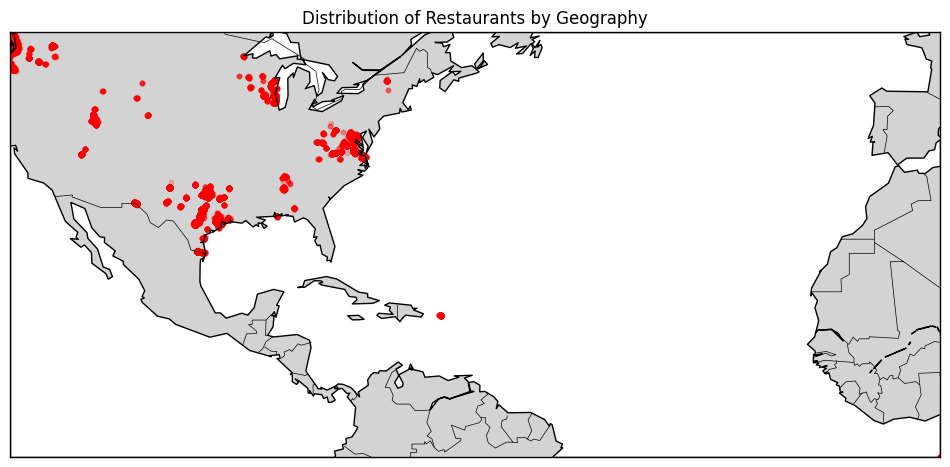

In [9]:
# Set up the basemap
plt.figure(figsize=(12, 8))
m = Basemap(projection='merc', llcrnrlat=min(df_restaurants['lat']), urcrnrlat=max(df_restaurants['lat']),
            llcrnrlon=min(df_restaurants['long']), urcrnrlon=max(df_restaurants['long']), lat_ts=20, resolution='c')

m.drawcoastlines()
m.drawcountries()
m.fillcontinents(color='lightgray', lake_color='white')
m.drawmapboundary(fill_color='white')

# Plot each restaurant location
x, y = m(df_restaurants['long'].values, df_restaurants['lat'].values)
m.scatter(x, y, s=10, color='red', marker='o', alpha=0.2)

plt.title('Distribution of Restaurants by Geography')
plt.show()

The above map shows the restaurant distribution.

As you can see the above map is not very clear. Hence we would create another map using a different python package.

In [10]:
# Calculate average latitude and longitude for map initialization
average_latitude = df_restaurants['lat'].mean()
average_longitude = df_restaurants['long'].mean()

# Create a Folium map
m = folium.Map(location=[average_latitude, average_longitude], zoom_start=12)

# Add markers for each restaurant
for _, row in df_restaurants.iterrows():
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=2,  # Size of the circle marker
        color='red',
        fill=True,
        fill_opacity=0.2
    ).add_to(m)

# Display the map
m


The above map is a folium map. The main advantage of this map is that we can zoom in and zoom out. hence we can pin point to any location and see the pattern.

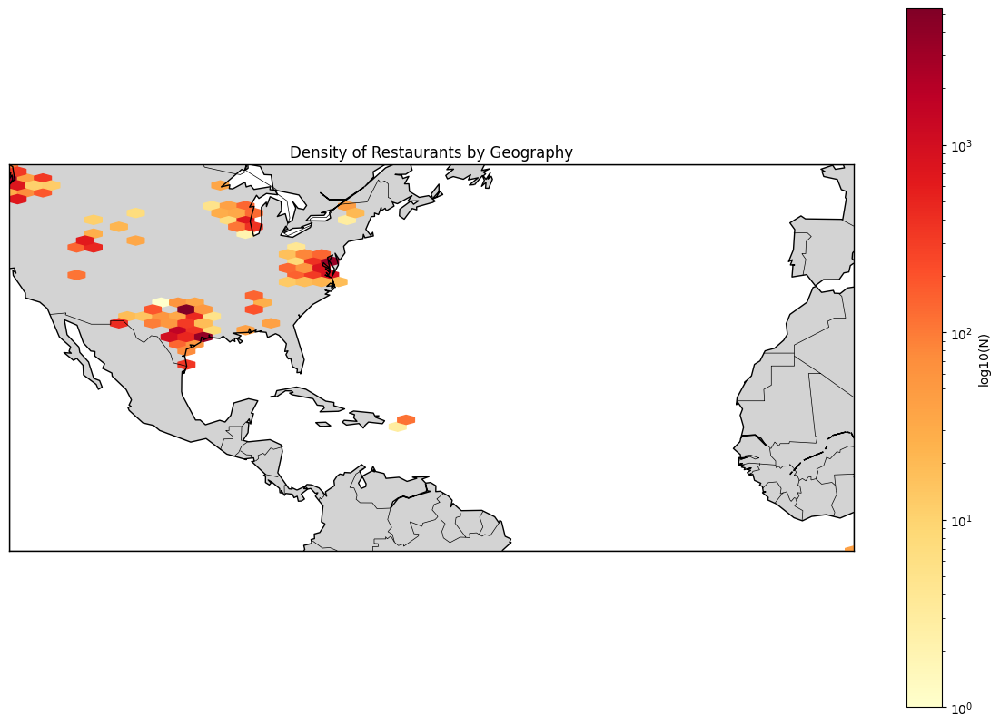

In [11]:
# Set up the basemap
plt.figure(figsize=(15, 10))
m = Basemap(projection='merc', llcrnrlat=min(df_restaurants['lat']), urcrnrlat=max(df_restaurants['lat']),
            llcrnrlon=min(df_restaurants['long']), urcrnrlon=max(df_restaurants['long']), lat_ts=20, resolution='c')
m.drawcoastlines()
m.drawcountries()
m.fillcontinents(color='lightgray', lake_color='white')
m.drawmapboundary(fill_color='white')

# Convert lat/long to map projection coordinates
x, y = m(df_restaurants['long'].values, df_restaurants['lat'].values)

# Create a hexbin plot
m.hexbin(x, y, gridsize=50, cmap='YlOrRd', bins='log')
plt.colorbar(label='log10(N)')

plt.title('Density of Restaurants by Geography')
plt.show()


The above map is another version of basemap. These restaurants are converted in hexbins. The number of restaurants are in log scale. 

In [48]:
from folium.plugins import HeatMap
import branca.colormap as cm

# Calculate average latitude and longitude for map initialization
average_latitude = df_restaurants['lat'].mean()
average_longitude = df_restaurants['long'].mean()

# Create a Folium map
m = folium.Map(location=[average_latitude, average_longitude], zoom_start=12)

# Create a HeatMap
heatmap_data = [[row['lat'], row['long']] for index, row in df_restaurants.iterrows()]
HeatMap(heatmap_data, radius=10, gradient={0.2: 'blue', 0.4: 'purple', 0.6: 'orange', 1: 'red'}).add_to(m)

# Display the map
m


The above map is a folium heatmap. It also depicts the restaurant densities in the US.

Lets understand the price range distribution of restaurants in the US.

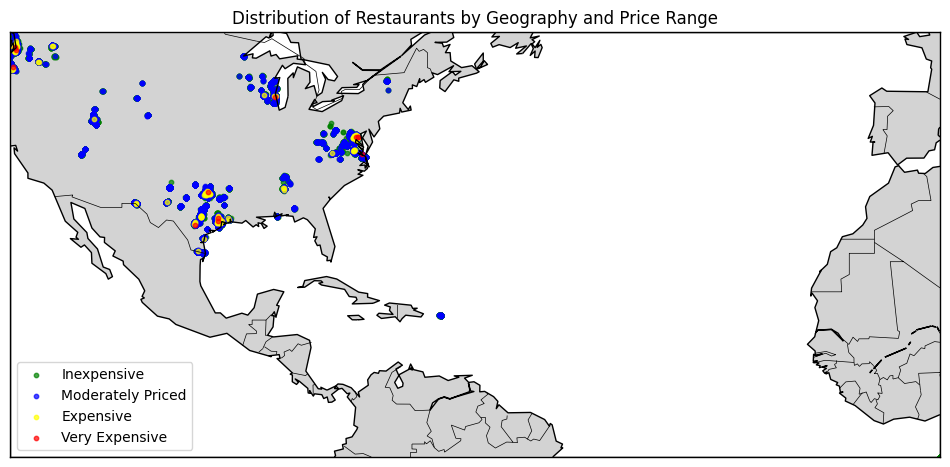

In [12]:
# Set up the basemap
plt.figure(figsize=(12, 8))
m = Basemap(projection='merc', llcrnrlat=min(df_restaurants['lat']), urcrnrlat=max(df_restaurants['lat']),
            llcrnrlon=min(df_restaurants['long']), urcrnrlon=max(df_restaurants['long']), lat_ts=20, resolution='c')
m.drawcoastlines()
m.drawcountries()
m.fillcontinents(color='lightgray', lake_color='white')
m.drawmapboundary(fill_color='white')

# Plot restaurants with different markers based on price range
color_map = {'Inexpensive': 'green', 'Moderately Priced': 'blue', 'Expensive': 'yellow', 'Very Expensive': 'red'}
label_map = {'Inexpensive': 'Inexpensive', 'Moderately Priced': 'Moderately Priced', 'Expensive': 'Expensive', 'Very Expensive': 'Very Expensive'}
for price_range, color in color_map.items():
    subset = df_restaurants[df_restaurants['price_range'] == price_range]
    x, y = m(subset['long'].values, subset['lat'].values)
    m.scatter(x, y, s=10, color=color, marker='o', alpha=0.7, label=label_map[price_range])

plt.title('Distribution of Restaurants by Geography and Price Range')
plt.legend(loc='lower left')
plt.show()


As we can see from the above chart, its not very clear. Hence we are improving it further by creating a folium map.

In [13]:
optimized_data = df_restaurants[['lat', 'long', 'zip_code', 'category']]

# Group data by zip code and category and count occurrences
category_counts = optimized_data.groupby(['zip_code', 'category']).size().reset_index(name='counts')

# Analyze the most popular category in each zip code
popular_categories = category_counts.loc[category_counts.groupby('zip_code')['counts'].idxmax()]

# Choose top N categories to display in the legend
top_categories = popular_categories['category'].value_counts().nlargest(5).index
popular_categories_filtered = popular_categories[popular_categories['category'].isin(top_categories)]

# Create a color map for top categories
colors = ['Orange', 'Blue', 'Green', 'Yellow']
category_to_color = {category: colors[i % len(colors)] for i, category in enumerate(top_categories)}

# Create a Folium map
average_latitude = optimized_data['lat'].mean()
average_longitude = optimized_data['long'].mean()
m = folium.Map(location=[average_latitude, average_longitude], zoom_start=12)

# Plot each zip code region with a color based on its most popular category
for _, row in popular_categories_filtered.iterrows():
    subset = optimized_data[optimized_data['zip_code'] == row['zip_code']]
    folium.CircleMarker(
        location=[subset['lat'].mean(), subset['long'].mean()],
        radius=3,
        color=category_to_color[row['category']],
        fill=True,
        fill_color=category_to_color[row['category']],
        fill_opacity=0.7,
        popup=f"Zip Code: {row['zip_code']}, Popular Category: {row['category']}"
    ).add_to(m)

# Define the HTML for the legend
legend_html = '''
<div style="position: fixed; 
     bottom: 10px; left: 10px; width: 200px; height: 130px; 
     background-color: white; border:2px solid grey; z-index:9999; font-size:14px;
     padding: 10px;">
     <b>Price Range:</b><br>
     <i style="background-color:Orange;color:Orange">()</i> Inexpensive<br>
     <i style="background-color:Blue;color:Blue">()</i> Moderately Priced<br>
     <i style="background-color:Green;color:Green">()</i> Expensive<br>
     <i style="background-color:Yellow;color:Yellow">()</i> Very Expensive
</div>
'''

# Add the legend to the map
legend = folium.Element(legend_html)
m.get_root().html.add_child(legend)

# Display the map
m


Lets understand the top restaurant categories distribution in the map of US.

In [32]:
colors = [
    '#E69F00',  # Orange
    '#56B4E9',  # Sky Blue
    '#009E73',  # Bluish Green
    '#F0E442',  # Yellow
    '#D55E00',  # Vermilion
]

# Dynamically assign a color to each category in top_categories
color_cycle = itertools.cycle(colors)  # Create a cycle iterator for colors
category_to_color = {category: next(color_cycle) for category in top_categories}

# Select the top categories based on occurrence
top_categories_count = 5
top_categories = df_restaurants['category'].value_counts().head(top_categories_count).index

# Filter the DataFrame to include only top categories
filtered_df = df_restaurants[df_restaurants['category'].isin(top_categories)]

# Create a base map
m = folium.Map(location=[filtered_df['lat'].mean(), filtered_df['long'].mean()], zoom_start=5)



# Add markers to the map
for _, row in filtered_df.iterrows():
    category_color = category_to_color[row['category']]
    folium.CircleMarker(
        location=[row['lat'], row['long']],
        radius=3,
        color=category_color,
        fill=True,
        fill_color=category_color,
        fill_opacity=0.5
    ).add_to(m)

legend_html = '''
<div style="position: fixed; 
     bottom: 10px; left: 10px; width: 280px; height: 150px; 
     background-color: white; border:2px solid grey; z-index:9999; font-size:9px;
     padding: 10px;">
     <b>Restaurant Categories:</b><br>
     '''
for category, color in category_to_color.items():
    legend_html += f'<div style="margin: 2px; display: flex; align-items: center;"><div style="background-color:{color};width:20px;height:20px; margin-right: 5px;"></div>{category}</div>'

legend_html += '</div>'

# Add the legend HTML to the map
m.get_root().html.add_child(folium.Element(legend_html))

# Display the map
m


Lets understand the count of these top 5 restaurant categories.

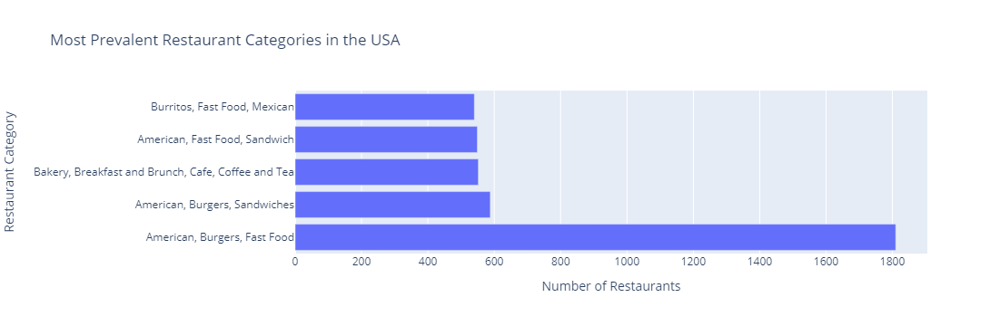

In [49]:
import plotly.express as px

# Select the top categories based on occurrence
top_categories_count = 5
top_categories = df_restaurants['category'].value_counts().head(top_categories_count)

# Convert the Series to a DataFrame for Plotly
top_categories_df = top_categories.reset_index()
top_categories_df.columns = ['Restaurant Category', 'Number of Restaurants']

# Create the plot using Plotly Express
fig = px.bar(top_categories_df, x='Number of Restaurants', y='Restaurant Category', orientation='h',
             title='Most Prevalent Restaurant Categories in the USA')

# Update layout for better readability
fig.update_layout(xaxis_title='Number of Restaurants', yaxis_title='Restaurant Category')
fig.show()


From the above chart it is evident that the American, Burgers, Fast food is very popular and prevalent across the whole country. It is the most popular by a very clear margin.

Lets understand the rating score distribution for these restaurant categories.

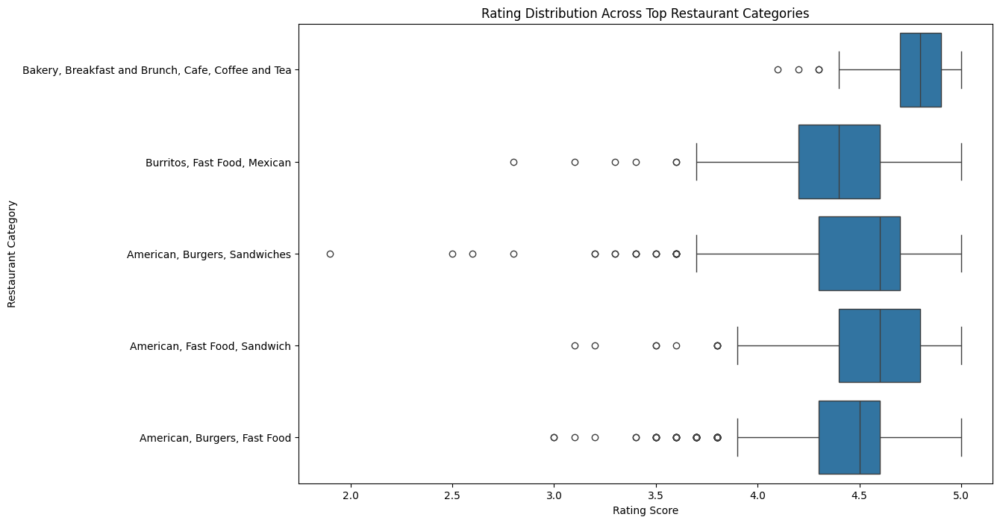

In [50]:
# Select the top 5 categories
top_categories_count = 5
top_categories = df_restaurants['category'].value_counts().head(top_categories_count).index

# Filter the DataFrame to include only top categories
filtered_df = df_restaurants[df_restaurants['category'].isin(top_categories)]

# Create the plot
plt.figure(figsize=(12, 8))
sns.boxplot(x='score', y='category', data=filtered_df)
plt.title('Rating Distribution Across Top Restaurant Categories')
plt.xlabel('Rating Score')
plt.ylabel('Restaurant Category')
plt.show()

From the above box plot, we can see that bakery, breakfast and brunch, cafe, coffee and tea have high score.

Lets understand the `Bakery', 'Breakfast and Brunch', 'Cafe', 'Coffee and Tea` category.

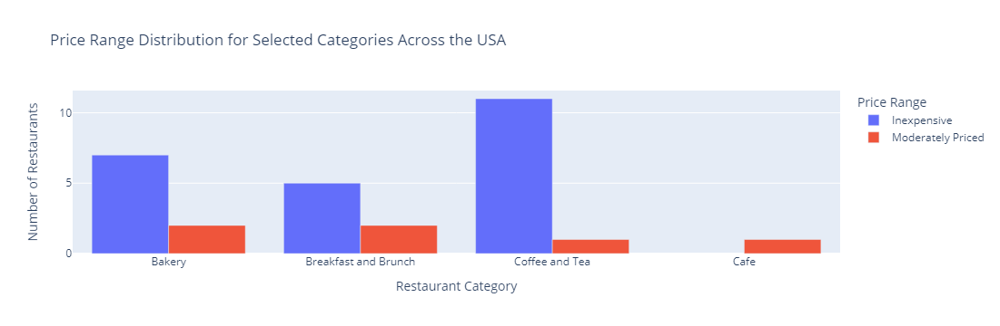

In [51]:
import plotly.express as px

# Define the categories of interest
categories_of_interest = ['Bakery', 'Breakfast and Brunch', 'Cafe', 'Coffee and Tea']

# Filter the DataFrame for these categories
filtered_df = df_restaurants[df_restaurants['category'].isin(categories_of_interest)]

# Group and count the number of restaurants by category and price range
grouped_data = filtered_df.groupby(['category', 'price_range']).size().reset_index(name='count')

# Create a bar graph
fig = px.bar(grouped_data, x='category', y='count', color='price_range',
             title='Price Range Distribution for Selected Categories Across the USA',
             barmode='group')

# Update layout for better readability
fig.update_layout(xaxis_title='Restaurant Category', yaxis_title='Number of Restaurants', legend_title="Price Range")
fig.show()


Lets understand the rating score distribution for different price ranges.

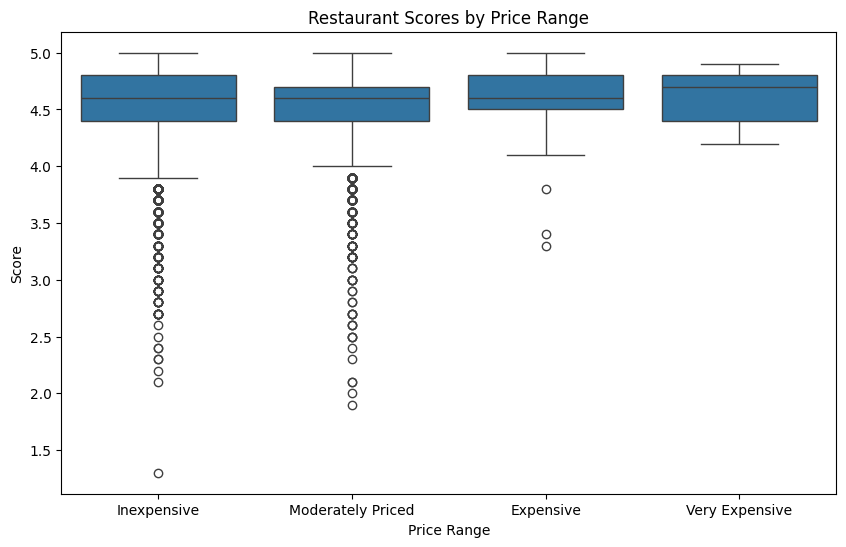

In [17]:
# Create a boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(x='price_range', y='score', data=df_restaurants, order=['Inexpensive', 'Moderately Priced', 'Expensive', 'Very Expensive'])
plt.title('Restaurant Scores by Price Range')
plt.xlabel('Price Range')
plt.ylabel('Score')
plt.show()


Lets understand which state has the most restaurants.

C:\Users\New User\AppData\Local\Temp\ipykernel_12640\1740414730.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




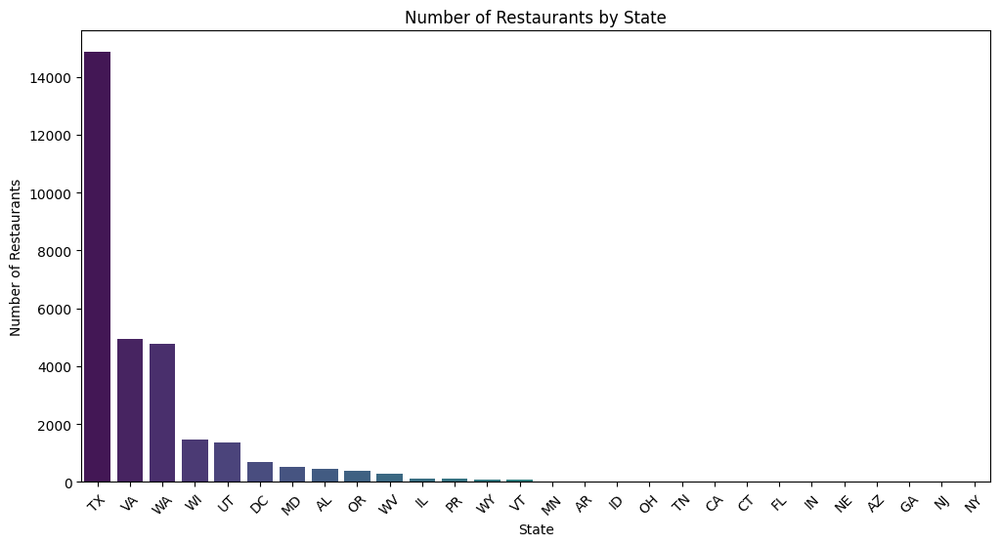

In [52]:
# Count the number of restaurants in each state
state_counts = df_restaurants['state'].value_counts()

# Create a bar chart
plt.figure(figsize=(12, 6))
sns.barplot(x=state_counts.index, y=state_counts.values, palette='viridis')
plt.title('Number of Restaurants by State')
plt.xlabel('State')
plt.ylabel('Number of Restaurants')
plt.xticks(rotation=45)  # Rotate the state names for better readability
plt.show()


Lets understand the distribution of scores for top 5 states with highest number of restaurants 

C:\Users\New User\AppData\Local\Temp\ipykernel_12640\2536084013.py:12: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




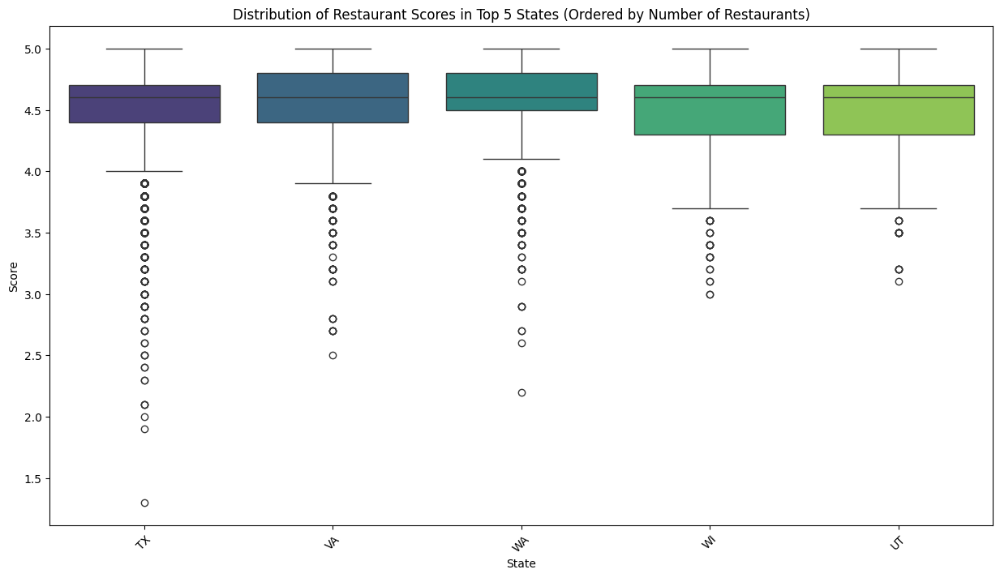

In [53]:
## Identify top 10 states by the number of restaurants
top_10_states = df_restaurants['state'].value_counts().nlargest(5).index

# Filter data to include only restaurants from these top 10 states
top_states_data = df_restaurants[df_restaurants['state'].isin(top_10_states)]

# Create an ordered list of states based on the number of restaurants
ordered_states = df_restaurants['state'].value_counts().nlargest(5).index.tolist()

# Create a boxplot for the top 10 states, ordered by the number of restaurants
plt.figure(figsize=(15, 8))
sns.boxplot(x='state', y='score', data=top_states_data, order=ordered_states, palette='viridis')
plt.title('Distribution of Restaurant Scores in Top 5 States (Ordered by Number of Restaurants)')
plt.xlabel('State')
plt.ylabel('Score')
plt.xticks(rotation=45)  # Rotate the state names for better readability
plt.show()


What are the most popular restaurant categories in Texas?

Understand which types of cuisine or dining experiences are most prevalent in Texas.

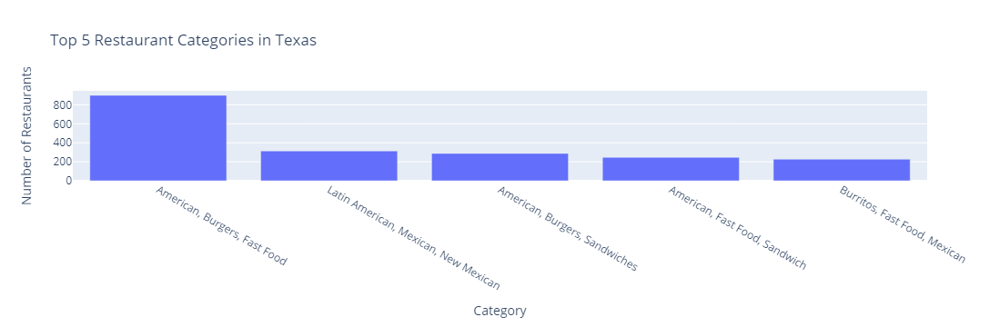

In [54]:
# Filter data for Texas
tx_restaurants = df_restaurants[df_restaurants['state'] == 'TX']

# Count the number of restaurants in each category and select the top 10
top_categories = tx_restaurants['category'].value_counts().nlargest(5).reset_index()
top_categories.columns = ['Category', 'Number of Restaurants']

# Create a bar chart for the top 10 categories
fig = px.bar(top_categories, x='Category', y='Number of Restaurants', title='Top 5 Restaurant Categories in Texas')
fig.update_layout(xaxis_title='Category', yaxis_title='Number of Restaurants')
fig.show()


Cities with highest number of restaurants

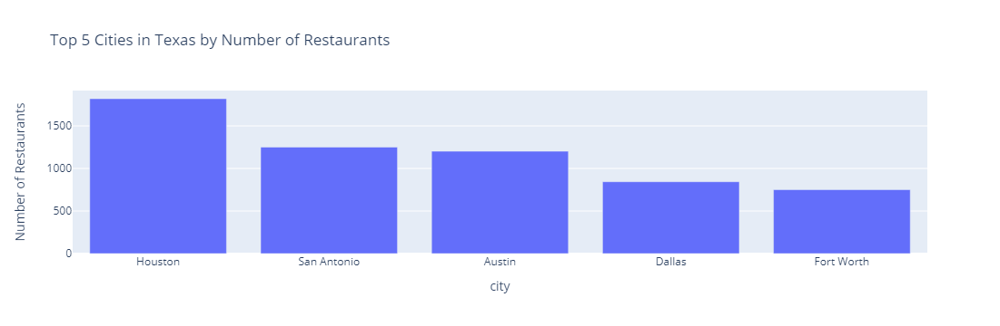

In [304]:
# Count the number of restaurants in each city
city_counts = tx_restaurants['city'].value_counts()

# Select the top 5 cities
top_cities = city_counts.nlargest(5)

# Create a bar chart
fig = px.bar(top_cities, 
             x=top_cities.index, 
             y=top_cities.values, 
             title='Top 5 Cities in Texas by Number of Restaurants',
             labels={'x': 'City', 'y': 'Number of Restaurants'})
fig.show()


Distribution of restaurant scores for top 5 cities.

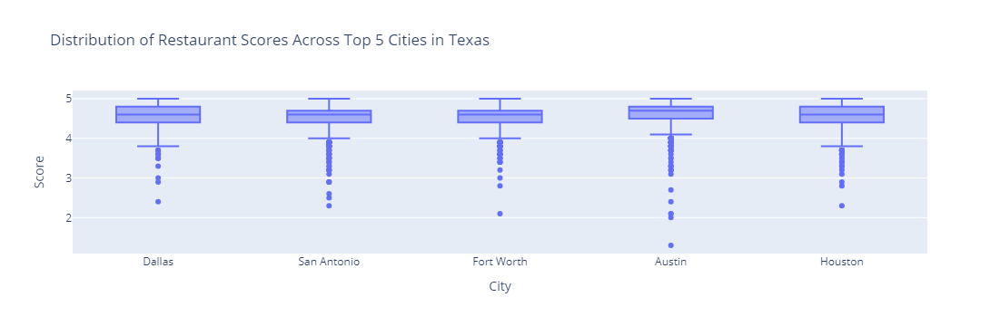

In [305]:
# Filter data for restaurants in Texas
tx_restaurants = df_restaurants[df_restaurants['state'] == 'TX']

# Identify top 5 cities in Texas based on the number of restaurants
top_cities = tx_restaurants['city'].value_counts().nlargest(5).index

# Filter the DataFrame to include only restaurants in these top cities
top_cities_restaurants = tx_restaurants[tx_restaurants['city'].isin(top_cities)]

# Create a boxplot of scores across the top 5 cities in Texas
fig = px.box(top_cities_restaurants, x='city', y='score', title='Distribution of Restaurant Scores Across Top 5 Cities in Texas')
fig.update_layout(xaxis_title='City', yaxis_title='Score')
fig.show()


 Explore if higher-priced restaurants tend to have higher scores, indicating a correlation between price and perceived quality.

C:\Users\New User\AppData\Local\Temp\ipykernel_12640\1639427073.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



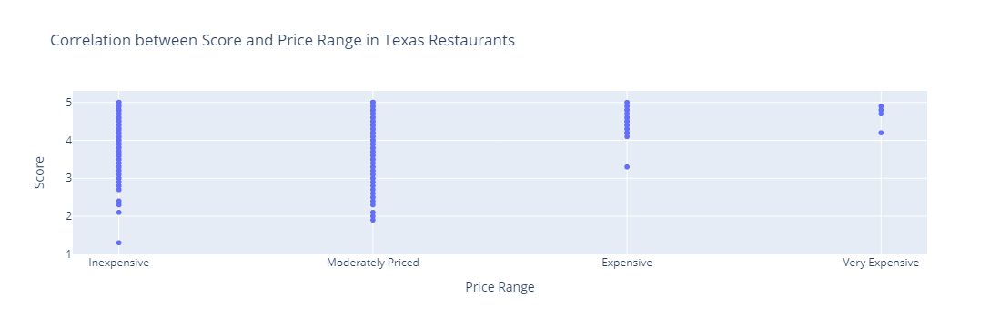

In [55]:
# Filter data for restaurants in Texas
tx_restaurants = df_restaurants[df_restaurants['state'] == 'TX']

# Encode price ranges into numerical values
price_range_mapping = {'Inexpensive': 'Inexpensive', 'Moderately Priced': 'Moderately Priced', 'Expensive': 'Expensive', 'Very Expensive': 'Very Expensive'}
tx_restaurants['price_range_encoded'] = tx_restaurants['price_range'].map(price_range_mapping)

# Create a scatter plot
fig = px.scatter(tx_restaurants, x='price_range_encoded', y='score', title='Correlation between Score and Price Range in Texas Restaurants',
                 labels={'price_range_encoded': 'Price Range', 'score': 'Score'},
                 category_orders={'price_range_encoded': ['Inexpensive', 'Moderately Priced', 'Expensive', 'Very Expensive']})
fig.show()



How does the diversity of restaurant types vary across Texas?

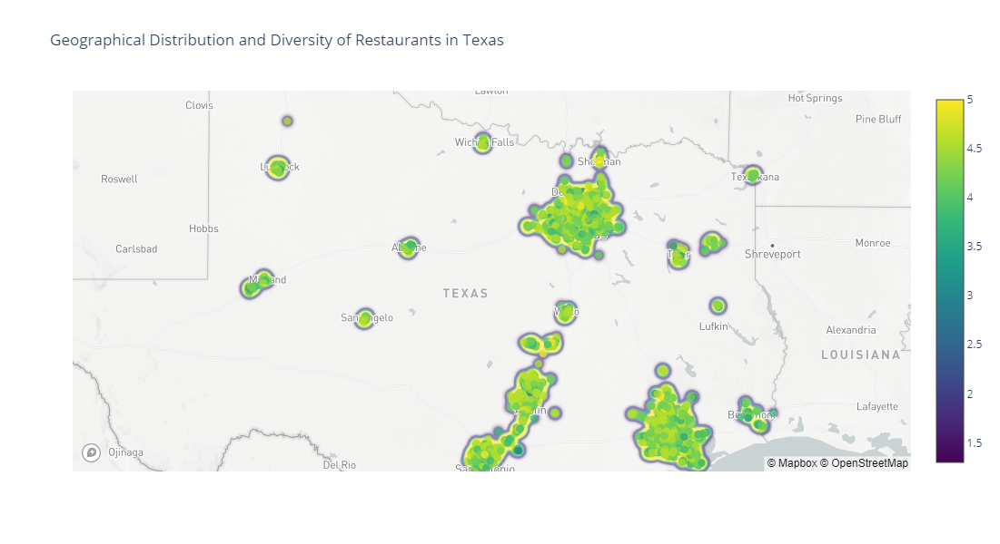

In [308]:
import plotly.express as px
import plotly.graph_objects as go

# Filter data for restaurants in Texas
tx_restaurants = df_restaurants[df_restaurants['state'] == 'TX']

# Normalize the scores for color mapping (between 0 and 1)
scores_normalized = (tx_restaurants['score'] - tx_restaurants['score'].min()) / (tx_restaurants['score'].max() - tx_restaurants['score'].min())

# Get the Viridis colorscale
viridis_scale = px.colors.sequential.Viridis

# Function to map normalized score to color
def map_score_to_color(score):
    index = int(score * (len(viridis_scale) - 1))
    return viridis_scale[index]

# Map each score to a color
colors = scores_normalized.apply(map_score_to_color)

# Create a base map centered on Texas
fig = go.Figure(go.Scattermapbox(
    lat=tx_restaurants['lat'],
    lon=tx_restaurants['long'],
    mode='markers',
    marker=go.scattermapbox.Marker(size=9, color=colors, opacity=0.7),
    text=tx_restaurants['category'],
))

# Set the layout for the map
fig.update_layout(
    mapbox=dict(
        accesstoken=YOUR_MAPBOX_ACCESS_TOKEN,  # Replace with your Mapbox access token
        center=go.layout.mapbox.Center(lat=31.9686, lon=-99.9018),  # Center on Texas
        zoom=5
    ),
    showlegend=False,
    title_text='Geographical Distribution and Diversity of Restaurants in Texas',
    width=800,  # Set width of the map
    height=600  # Set height of the map
)

# Add a heat map layer for restaurant concentration
fig.add_trace(go.Densitymapbox(
    lat=tx_restaurants['lat'],
    lon=tx_restaurants['long'],
    z=tx_restaurants['score'],
    radius=10,
    colorscale='Viridis',
    opacity=0.6,
))

fig.show()


Top 5 cities with dining diversity in Texas


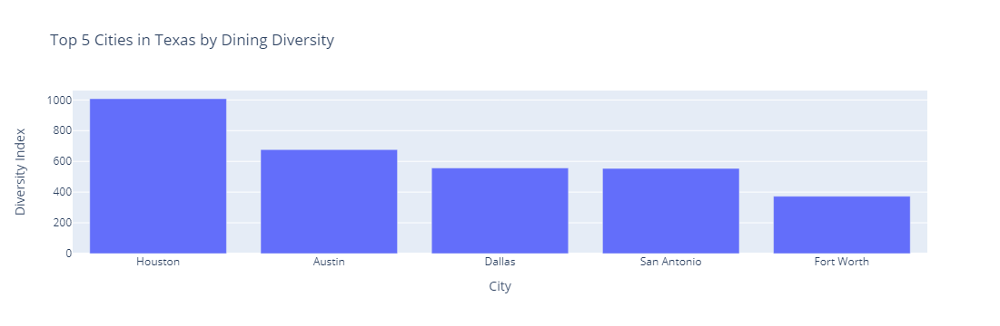

In [309]:
# Filter data for restaurants in Texas
tx_restaurants = df_restaurants[df_restaurants['state'] == 'TX']

# Count unique categories in each city within Texas
city_diversity_tx = tx_restaurants.groupby('city')['category'].nunique().reset_index()
city_diversity_tx.columns = ['city', 'diversity_index']

# Select top N cities for diversity in Texas
top_city_diversity_tx = city_diversity_tx.nlargest(5, 'diversity_index')

# Create a bar chart for the top cities in Texas
fig = px.bar(top_city_diversity_tx, x='city', y='diversity_index', title='Top 5 Cities in Texas by Dining Diversity')
fig.update_layout(xaxis_title='City', yaxis_title='Diversity Index')
fig.show()


Understanding the price range for top 5 cities in Texas

Number of restaurants in Texas: 14859


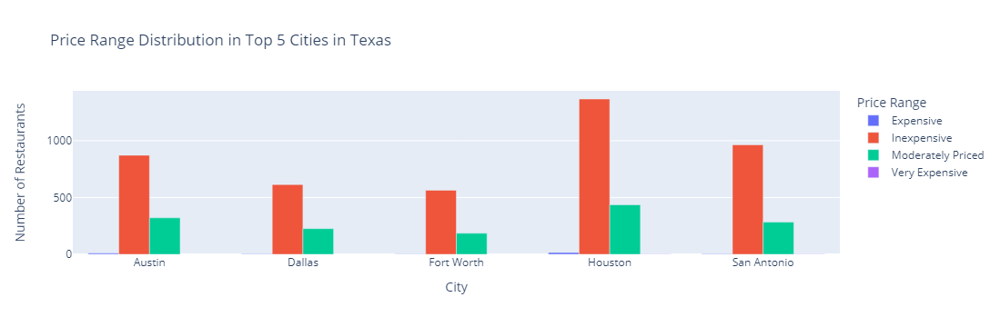

In [57]:
# Ensure the state and city columns are correctly formatted (as strings)
df_restaurants['state'] = df_restaurants['state'].astype(str)
df_restaurants['city'] = df_restaurants['city'].astype(str)

# Filter data for restaurants in Texas
tx_restaurants = df_restaurants[df_restaurants['state'] == 'TX']

# Check if the filtering worked
print("Number of restaurants in Texas:", len(tx_restaurants))

# Identify top 5 cities in Texas by the number of restaurants
top_5_cities = tx_restaurants['city'].value_counts().nlargest(5).index

# Filter data to include only restaurants from these top 5 cities
top_cities_restaurants = tx_restaurants[tx_restaurants['city'].isin(top_5_cities)]

# Prepare data for grouped bar chart
grouped_data = top_cities_restaurants.groupby(['city', 'price_range']).size().reset_index(name='count')


# Create a grouped bar chart for price range distribution in these cities
fig = px.bar(grouped_data, x='city', y='count', color='price_range', barmode='group',
             title='Price Range Distribution in Top 5 Cities in Texas')
fig.update_layout(xaxis_title='City', yaxis_title='Number of Restaurants', legend_title="Price Range")
fig.show()


Understanding the restaurant categories in Houston

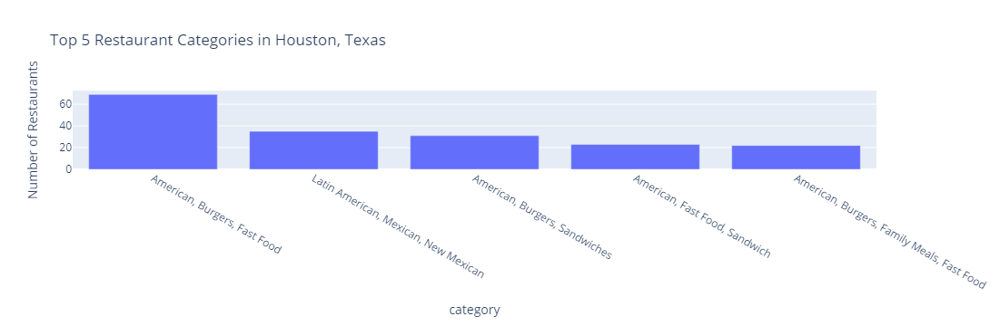

In [311]:
import plotly.express as px

# Filter data for restaurants in Houston, Texas
houston_restaurants = tx_restaurants[tx_restaurants['city'] == 'Houston']

# Count the number of restaurants in each category
category_counts_houston = houston_restaurants['category'].value_counts()

# Select the top 5 categories
top_categories_houston = category_counts_houston.nlargest(5)

# Create a bar chart for the top 5 categories
fig = px.bar(top_categories_houston, 
             x=top_categories_houston.index, 
             y=top_categories_houston.values, 
             title='Top 5 Restaurant Categories in Houston, Texas',
             labels={'x': 'Category', 'y': 'Number of Restaurants'})
fig.show()


Understanding the correlation between rating score and price range in Houston

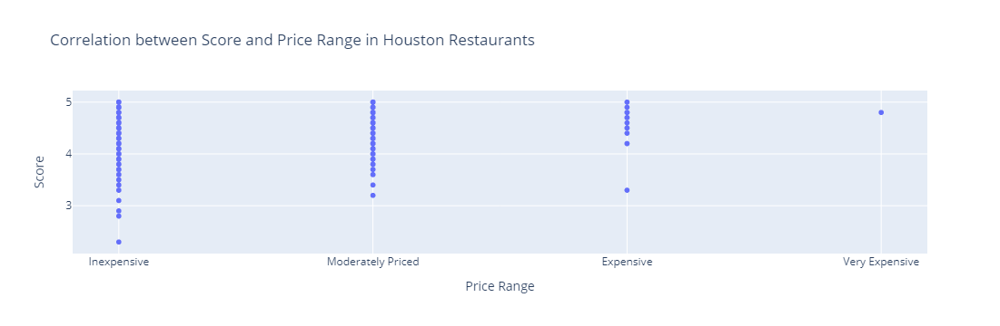

In [312]:
import plotly.express as px

# Filter data for restaurants in Houston, Texas
houston_restaurants = df_restaurants[(df_restaurants['city'] == 'Houston') & (df_restaurants['state'] == 'TX')]

# Since the price range mapping is just a direct mapping, we can use the 'price_range' column directly
# Create a scatter plot
fig = px.scatter(houston_restaurants, x='price_range', y='score', 
                 title='Correlation between Score and Price Range in Houston Restaurants',
                 labels={'price_range': 'Price Range', 'score': 'Score'},
                 category_orders={'price_range': ['Inexpensive', 'Moderately Priced', 'Expensive', 'Very Expensive']})
fig.show()


Understanding the overall distribution of price range in the map of Houston

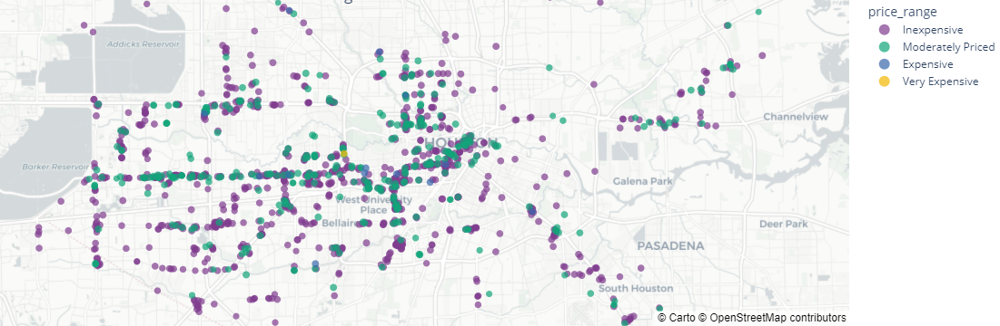

In [313]:
import plotly.express as px

# Filter data for restaurants in Houston, Texas
houston_restaurants = df_restaurants[(df_restaurants['city'] == 'Houston') & (df_restaurants['state'] == 'TX')]

# Create a scatter map using Plotly Express
fig = px.scatter_mapbox(houston_restaurants, 
                        lat="lat", 
                        lon="long", 
                        color="price_range",
                        size="score",
                        hover_name="restaurant_name",  # Assuming 'name' is the column for restaurant names
                        hover_data=["score", "price_range"],
                        zoom=10,
                        title='Correlation between Score and Price Range in Houston Restaurants',
                        color_discrete_sequence=px.colors.qualitative.Bold,
                        size_max=6)

# Update the layout to use a suitable map style
fig.update_layout(mapbox_style="carto-positron",
                  margin={"r":0,"t":0,"l":0,"b":0})

fig.show()


Understanding the `Bakery', 'Breakfast and Brunch', 'Cafe', 'Coffee and Tea` category for Houston

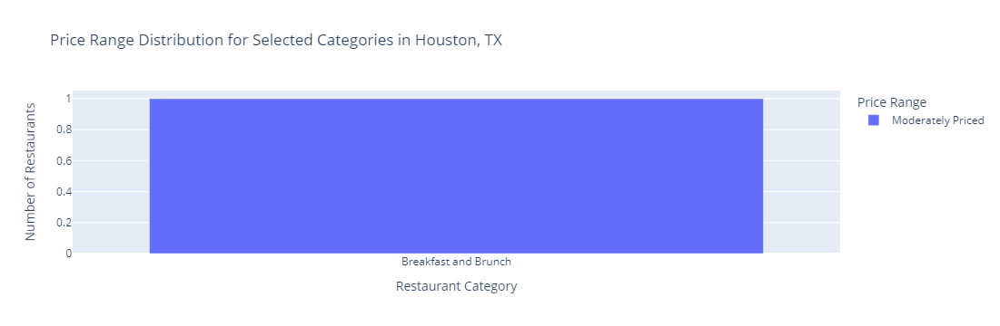

In [46]:
import plotly.express as px

# Define the categories of interest
categories_of_interest = ['Bakery', 'Breakfast and Brunch', 'Cafe', 'Coffee and Tea']

# Filter the DataFrame for these categories and for restaurants in Houston, Texas
houston_df = df_restaurants[(df_restaurants['city'] == 'Houston') & (df_restaurants['state'] == 'TX')]
filtered_houston_df = houston_df[houston_df['category'].isin(categories_of_interest)]

# Group and count the number of restaurants by category and price range in Houston
grouped_data_houston = filtered_houston_df.groupby(['category', 'price_range']).size().reset_index(name='count')

# Create a bar graph for Houston, TX
fig = px.bar(grouped_data_houston, x='category', y='count', color='price_range',
             title='Price Range Distribution for Selected Categories in Houston, TX',
             barmode='group')

# Update layout for better readability
fig.update_layout(xaxis_title='Restaurant Category', yaxis_title='Number of Restaurants', legend_title="Price Range")
fig.show()


From the above graph, it is quite evident that the only category is Breakfast and brunch out of "Bakery', 'Breakfast and Brunch', 'Cafe', 'Coffee and Tea". Also, this category is moderately priced. This gives us a sign that perhaps this category is pricey or since the other categories are not present, it is not showing up as a top 5 categories.

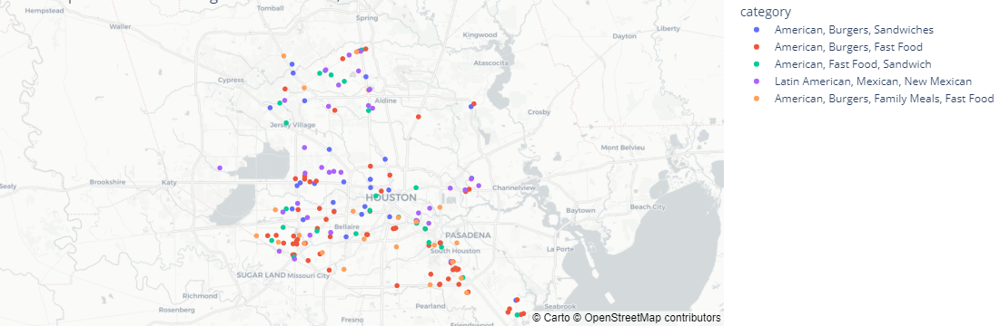

In [314]:
import plotly.express as px

# Filter data for restaurants in Houston, Texas
houston_restaurants = tx_restaurants[tx_restaurants['city'] == 'Houston']

# Count the number of restaurants in each category and get the top 5 categories
top_5_categories = houston_restaurants['category'].value_counts().nlargest(5).index

# Filter Houston restaurants to include only those in the top 5 categories
houston_top_categories = houston_restaurants[houston_restaurants['category'].isin(top_5_categories)]

# Create a map using Plotly Express with the 'carto-positron' style
fig = px.scatter_mapbox(houston_top_categories, 
                        lat="lat", 
                        lon="long", 
                        color="category",
                        hover_name="category",
                        zoom=10,
                        title="Top 5 Restaurant Categories in Houston, Texas")

# Update the layout to use the 'carto-positron' map style
fig.update_layout(mapbox_style="carto-positron",
                  margin={"r":0,"t":0,"l":0,"b":0})

fig.show()


The above map is for top 5 restaurant category distribution in Houston.

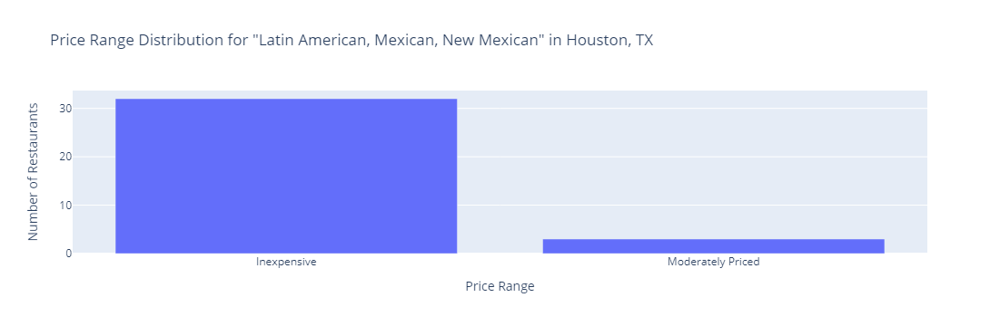

In [47]:
import plotly.express as px

# Filter data for restaurants in Houston, Texas, in the specific category
houston_category = df_restaurants[(df_restaurants['city'] == 'Houston') & 
                                  (df_restaurants['state'] == 'TX') &
                                  (df_restaurants['category'] == 'Latin American, Mexican, New Mexican')]

# Group and count the number of restaurants by price range within this category
grouped_data_houston = houston_category.groupby('price_range').size().reset_index(name='count')

# Create a bar graph
fig = px.bar(grouped_data_houston, x='price_range', y='count',
             title='Price Range Distribution for "Latin American, Mexican, New Mexican" in Houston, TX',
             labels={'price_range': 'Price Range', 'count': 'Number of Restaurants'})

# Update layout for better readability
fig.update_layout(xaxis_title='Price Range', yaxis_title='Number of Restaurants')
fig.show()


This is a price range distribution for the second most popular restaurant category in Houston.
This category is not present in the top 5 restaurant category of the US. Hence we can observe that simpsons paradox is at play here. 